<a href="https://colab.research.google.com/github/shivapriya19/shivapriya19/blob/main/Spike_Evaluate_ML_Face_Matching_Options.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **step 1**restart the runtime (from menu: Runtime → Restart runtime),
and after restarting, only run this import block:

In [3]:
import cv2
import mediapipe as mp
import numpy as np
import tensorflow as tf
import time
from google.colab import files

print("✅ All libraries imported successfully!")


✅ All libraries imported successfully!


In [1]:
!pip install mediapipe==0.10.21 opencv-python==4.10.0.84 tensorflow==2.17.1 numpy==1.26.4




# **step 2:** Upload Sample Face Images

# You can upload your own or use free test images (like face1.jpg, face2.jpg, face3.jpg).

In [6]:
# Upload multiple face images for testing
from google.colab import files

uploaded = files.upload()  # Choose multiple images at once


Saving face1.jpg.JPG to face1.jpg (2).JPG
Saving face2.jpg to face2 (1).jpg
Saving face3.jpg to face3.jpg


# **step 3:** Face Detection (Visual Check)

Run this code in your Colab cell 👇

✅ Face detected in face1.jpg.JPG


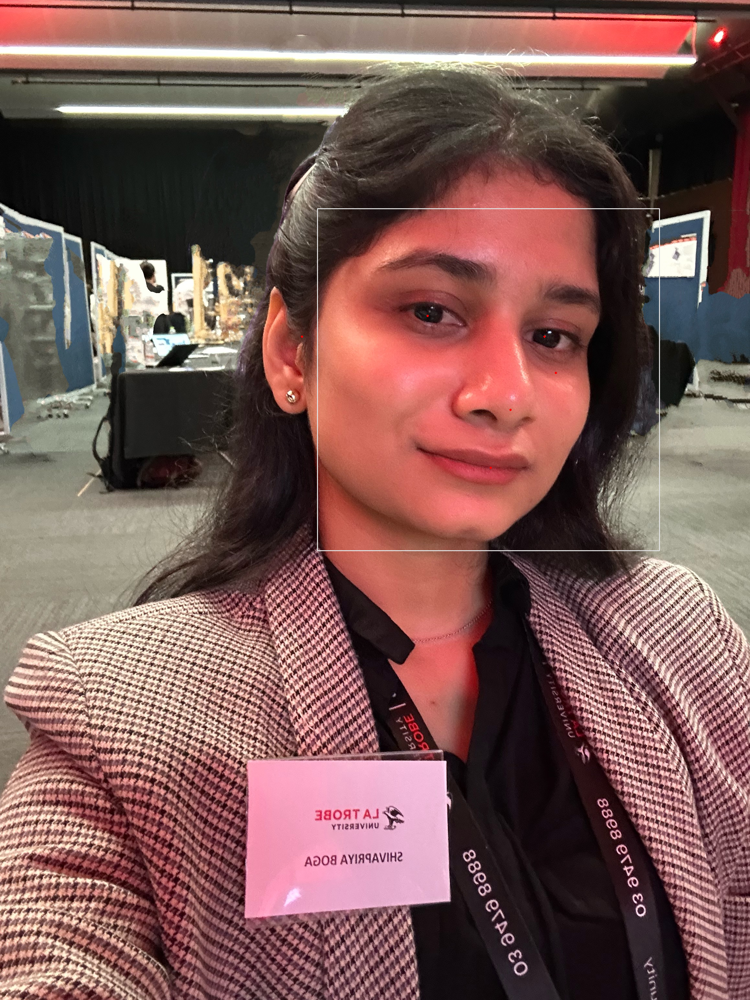

✅ Face detected in face2.jpg


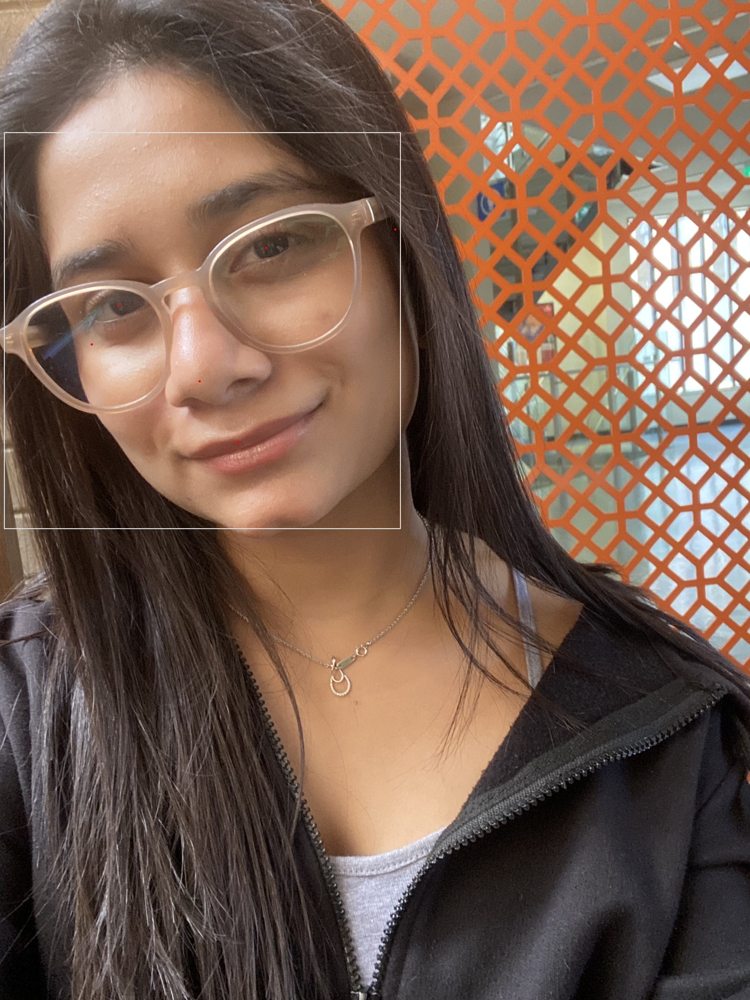

✅ Face detected in face3.jpg


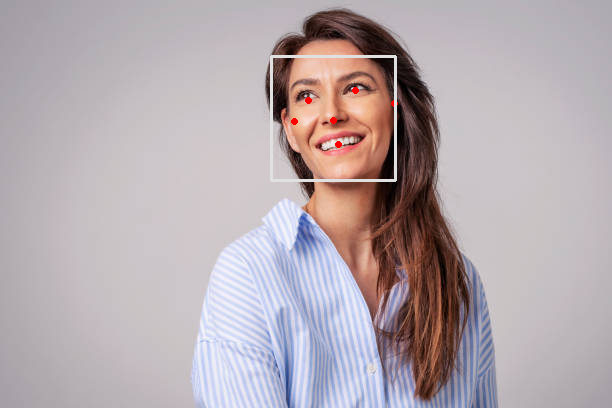

label_id: 0
score: 0.968772769
location_data {
  format: RELATIVE_BOUNDING_BOX
  relative_bounding_box {
    xmin: 0.443986773
    ymin: 0.138542473
    width: 0.202220798
    height: 0.303403914
  }
  relative_keypoints {
    x: 0.504616141
    y: 0.245845228
  }
  relative_keypoints {
    x: 0.58095932
    y: 0.221742183
  }
  relative_keypoints {
    x: 0.544405162
    y: 0.295621872
  }
  relative_keypoints {
    x: 0.552724779
    y: 0.353574693
  }
  relative_keypoints {
    x: 0.481609046
    y: 0.298192978
  }
  relative_keypoints {
    x: 0.644147098
    y: 0.252764046
  }
}

In [9]:
import cv2
import mediapipe as mp
import numpy as np
from google.colab.patches import cv2_imshow  # for displaying in Colab

mp_face_detection = mp.solutions.face_detection
mp_drawing = mp.solutions.drawing_utils

def detect_face_mediapipe(image_path):
    image = cv2.imread(image_path)
    image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

    with mp_face_detection.FaceDetection(model_selection=1, min_detection_confidence=0.5) as face_detection:
        results = face_detection.process(image_rgb)

        if not results.detections:
            print(f"❌ No face detected in {image_path}")
            return None

        # Draw bounding boxes on the face
        for detection in results.detections:
            mp_drawing.draw_detection(image, detection)

        print(f"✅ Face detected in {image_path}")
        cv2_imshow(image)  # show image with box
        return results.detections[0]

# 🔍 Test on one of your uploaded images (replace file name if needed)
detect_face_mediapipe('face1.jpg.JPG')
detect_face_mediapipe('face2.jpg')
detect_face_mediapipe('face3.jpg')



In [2]:
!pip install facenet-pytorch


# **step 4:** Compare 3 faces

In [3]:
import cv2
import mediapipe as mp
import numpy as np
from PIL import Image
import torch
import torch.nn.functional as F
from facenet_pytorch import InceptionResnetV1

# Initialize MediaPipe and FaceNet
mp_face_detection = mp.solutions.face_detection
face_model = InceptionResnetV1(pretrained='vggface2').eval()

# --- Helper functions ---
def crop_face(image, detection):
    h, w, _ = image.shape
    bbox = detection.location_data.relative_bounding_box
    x_min = int(bbox.xmin * w)
    y_min = int(bbox.ymin * h)
    width = int(bbox.width * w)
    height = int(bbox.height * h)
    face_crop = image[y_min:y_min+height, x_min:x_min+width]
    return cv2.cvtColor(face_crop, cv2.COLOR_BGR2RGB)

def get_embedding(face_crop):
    face_img = Image.fromarray(face_crop).resize((160,160))
    face_tensor = torch.tensor(np.array(face_img)/255.0, dtype=torch.float32).permute(2,0,1).unsqueeze(0)
    embedding = face_model(face_tensor)
    return embedding

def compare_embeddings(emb1, emb2):
    cos_sim = F.cosine_similarity(emb1, emb2)
    euclid_dist = torch.dist(emb1, emb2)
    return cos_sim.item(), euclid_dist.item()

# --- Detect, crop, embed ---
def get_face_embedding(image_path):
    image = cv2.imread(image_path)
    with mp_face_detection.FaceDetection(model_selection=1, min_detection_confidence=0.5) as face_detection:
        detections = face_detection.process(cv2.cvtColor(image, cv2.COLOR_BGR2RGB)).detections
        if not detections:
            print(f"❌ No face detected in {image_path}")
            return None
        face_crop = crop_face(image, detections[0])
        emb = get_embedding(face_crop)
        return emb

# --- Compare all 3 images ---
image_files = ['face1.jpg.JPG', 'face2.jpg', 'face3.jpg']
embeddings = []

for img_file in image_files:
    emb = get_face_embedding(img_file)
    if emb is not None:
        embeddings.append(emb)
    else:
        embeddings.append(None)

# Pairwise comparison
for i in range(len(embeddings)):
    for j in range(i+1, len(embeddings)):
        if embeddings[i] is not None and embeddings[j] is not None:
            cos_sim, euclid_dist = compare_embeddings(embeddings[i], embeddings[j])
            print(f"{image_files[i]} vs {image_files[j]} → Cosine: {cos_sim:.3f}, Euclidean: {euclid_dist:.3f}")


  0%|          | 0.00/107M [00:00<?, ?B/s]

face1.jpg.JPG vs face2.jpg → Cosine: 0.672, Euclidean: 0.810
face1.jpg.JPG vs face3.jpg → Cosine: -0.158, Euclidean: 1.522
face2.jpg vs face3.jpg → Cosine: -0.058, Euclidean: 1.454


# **step 5:**
(run embeddings and similarity comparison)

Make sure you have the images uploaded:
'face1.jpg.JPG', 'face2.jpg', 'face3.jpg'

In [4]:
import cv2
import mediapipe as mp
import numpy as np
from PIL import Image
import torch
import torch.nn.functional as F
from facenet_pytorch import InceptionResnetV1

# Initialize MediaPipe and FaceNet
mp_face_detection = mp.solutions.face_detection
face_model = InceptionResnetV1(pretrained='vggface2').eval()

# --- Helper functions ---
def crop_face(image, detection):
    h, w, _ = image.shape
    bbox = detection.location_data.relative_bounding_box
    x_min = int(bbox.xmin * w)
    y_min = int(bbox.ymin * h)
    width = int(bbox.width * w)
    height = int(bbox.height * h)
    face_crop = image[y_min:y_min+height, x_min:x_min+width]
    return cv2.cvtColor(face_crop, cv2.COLOR_BGR2RGB)

def get_embedding(face_crop):
    face_img = Image.fromarray(face_crop).resize((160,160))
    face_tensor = torch.tensor(np.array(face_img)/255.0, dtype=torch.float32).permute(2,0,1).unsqueeze(0)
    embedding = face_model(face_tensor)
    return embedding

def compare_embeddings(emb1, emb2):
    cos_sim = F.cosine_similarity(emb1, emb2)
    euclid_dist = torch.dist(emb1, emb2)
    return cos_sim.item(), euclid_dist.item()

def get_face_embedding(image_path):
    image = cv2.imread(image_path)
    with mp_face_detection.FaceDetection(model_selection=1, min_detection_confidence=0.5) as face_detection:
        detections = face_detection.process(cv2.cvtColor(image, cv2.COLOR_BGR2RGB)).detections
        if not detections:
            print(f"❌ No face detected in {image_path}")
            return None
        face_crop = crop_face(image, detections[0])
        emb = get_embedding(face_crop)
        return emb

# --- Compare all 3 images ---
image_files = ['face1.jpg.JPG', 'face2.jpg', 'face3.jpg']
embeddings = []

for img_file in image_files:
    emb = get_face_embedding(img_file)
    if emb is not None:
        embeddings.append(emb)
    else:
        embeddings.append(None)

# Pairwise comparison
print("Pairwise similarity between faces:")
for i in range(len(embeddings)):
    for j in range(i+1, len(embeddings)):
        if embeddings[i] is not None and embeddings[j] is not None:
            cos_sim, euclid_dist = compare_embeddings(embeddings[i], embeddings[j])
            print(f"{image_files[i]} vs {image_files[j]} → Cosine: {cos_sim:.3f}, Euclidean: {euclid_dist:.3f}")


Pairwise similarity between faces:
face1.jpg.JPG vs face2.jpg → Cosine: 0.672, Euclidean: 0.810
face1.jpg.JPG vs face3.jpg → Cosine: -0.158, Euclidean: 1.522
face2.jpg vs face3.jpg → Cosine: -0.058, Euclidean: 1.454


# **step 6 **Measure latency

In [5]:
import time
import cv2
import mediapipe as mp

mp_face_detection = mp.solutions.face_detection

image_files = ['face1.jpg.JPG', 'face2.jpg', 'face3.jpg']

print("⏱ Measuring MediaPipe latency:")
for img_file in image_files:
    image = cv2.imread(img_file)
    image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

    start_time = time.time()
    with mp_face_detection.FaceDetection(model_selection=1, min_detection_confidence=0.5) as face_detection:
        results = face_detection.process(image_rgb)
    end_time = time.time()

    latency = (end_time - start_time) * 1000  # in milliseconds
    print(f"{img_file} → {latency:.2f} ms, Faces detected: {len(results.detections) if results.detections else 0}")


⏱ Measuring MediaPipe latency:
face1.jpg.JPG → 37.11 ms, Faces detected: 1
face2.jpg → 32.46 ms, Faces detected: 1
face3.jpg → 29.49 ms, Faces detected: 1


In [9]:
!pip install tensorflow


In [13]:
import cv2
import mediapipe as mp
import time

# Images
image_files = ['face1.jpg.JPG', 'face2.jpg', 'face3.jpg']

# --- MediaPipe setup ---
mp_face_detection = mp.solutions.face_detection

print("⏱ MediaPipe vs OpenCV Haar Cascade latency and faces detected:")

# Haar Cascade setup
haar_cascade = cv2.CascadeClassifier(cv2.data.haarcascades + "haarcascade_frontalface_default.xml")

for img_file in image_files:
    image = cv2.imread(img_file)
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

    # --- MediaPipe ---
    image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    start_time = time.time()
    with mp_face_detection.FaceDetection(model_selection=1, min_detection_confidence=0.5) as face_detection:
        results = face_detection.process(image_rgb)
    mp_latency = (time.time() - start_time) * 1000
    mp_faces = len(results.detections) if results.detections else 0

    # --- Haar Cascade ---
    start_time = time.time()
    faces_haar = haar_cascade.detectMultiScale(gray, scaleFactor=1.1, minNeighbors=5)
    haar_latency = (time.time() - start_time) * 1000
    haar_faces = len(faces_haar)

    # Print results
    print(f"{img_file} → MediaPipe: {mp_faces} face(s), {mp_latency:.2f} ms | "
          f"Haar Cascade: {haar_faces} face(s), {haar_latency:.2f} ms")


⏱ MediaPipe vs OpenCV Haar Cascade latency and faces detected:
face1.jpg.JPG → MediaPipe: 1 face(s), 37.19 ms | Haar Cascade: 4 face(s), 5507.83 ms
face2.jpg → MediaPipe: 1 face(s), 33.19 ms | Haar Cascade: 3 face(s), 5008.83 ms
face3.jpg → MediaPipe: 1 face(s), 46.76 ms | Haar Cascade: 2 face(s), 158.17 ms


In [14]:
!git clone https://github.com/shivapriya19/perf-capture/new/main


Cloning into 'main'...
fatal: repository 'https://github.com/shivapriya19/perf-capture/new/main/' not found


In [15]:
!mv /content/YourNotebook.ipynb /content/your-repo/


mv: cannot stat '/content/YourNotebook.ipynb': No such file or directory
